# 10 - Kaggle - bike share system - Random Forest - Comparing results

### Basic settings and importing the libraries

In [2]:
# Resets the namespace by removing all names defined by the user without asking for confirmation
%reset -f


# Panas is used for DataFrame
import pandas as pd

# NumPy is used for manipulating arrays
import numpy as np

# MatPlotLib is used for plotting
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# the output of plotting commands is displayed inline directly below the code cell that produced it.
%matplotlib inline

# Seaborn is used for statistical plotting
import seaborn as sns

# Used for display dataframes as html tables
from IPython.display import display

The Root Mean Squared Logarithmic Error (RMSLE) is calculated as

$$\epsilon = \sqrt{{1\over n} \sum_{i=1}^n \left[ \log(p_i+1) - \log(a_i+1)\right]^2}$$

*Where:*

- $n_i$ is the number of hours in the test set
- $p_i$ is your predicted count
- $a_i$ is the actual count
- $\log(x)$ is the natural logarithm


First we define a `Score function` and them make a scorer from a performance metric or loss function for use in [GridSearchCV](http://scikit-learn.org/stable/modules/generated/sklearn.grid_search.GridSearchCV.html) and [cross_val_score](http://scikit-learn.org/stable/modules/generated/sklearn.cross_validation.cross_val_score.html). For this purpose we use [sklearn.metrics.make_scorer](http://scikit-learn.org/stable/modules/generated/sklearn.metrics.make_scorer.html)

In [2]:
from sklearn.metrics import make_scorer

def rmsle (y, y_pred):
    return np.sqrt(((np.log1p(y_pred) - np.log1p(y))**2).mean())

rmsle_score = make_scorer(rmsle, greater_is_better=False)

### Importing the train data from `train_prep_orig.csv`

In [3]:
#Load train data
data_train = pd.read_csv('data/train_prep_orig_avg.csv')
data_l_train = pd.read_csv('data/train_prep_orig_l_avg.csv')

print "The shape of the train dataset:", data_train.shape
display(data_train.head())

print "The shape of the train dataset: (logarithm)", data_l_train.shape
display(data_l_train.head())



The shape of the train dataset: (10886, 18)


,temp,atemp,humidity,windspeed,year,season,month,weekday,hour,workingday,holiday,weather,avg_casual,avg_registered,avg_tot,casual,registered,tot
0,9.84,14.395,81.0,0.0,2011.0,1.0,1.0,5.0,0.0,0.0,0.0,1.0,3.0,21.166667,24.166667,3.0,13.0,16.0
1,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,1.0,0.0,0.0,1.0,3.0,21.166667,24.166667,8.0,32.0,40.0
2,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,2.0,0.0,0.0,1.0,1.0,7.500000,8.500000,5.0,27.0,32.0
3,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,3.0,0.0,0.0,1.0,1.0,7.500000,8.500000,3.0,10.0,13.0
4,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,4.0,0.0,0.0,1.0,1.0,7.500000,8.500000,0.0,1.0,1.0


The shape of the train dataset: (logarithm) (10886, 18)


,temp,atemp,humidity,windspeed,year,season,month,weekday,hour,workingday,holiday,weather,avg_l_casual,avg_l_registered,avg_l_tot,l_casual,l_registered,l_tot
0,9.84,14.395,81.0,0.0,2011.0,1.0,1.0,5.0,0.0,0.0,0.0,1.0,1.242453,3.054927,3.174986,1.386294,2.639057,2.833213
1,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,1.0,0.0,0.0,1.0,1.242453,3.054927,3.174986,2.197225,3.496508,3.713572
2,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,2.0,0.0,0.0,1.0,0.438125,1.787425,1.847208,1.791759,3.332205,3.496508
3,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,3.0,0.0,0.0,1.0,0.438125,1.787425,1.847208,1.386294,2.397895,2.639057
4,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,4.0,0.0,0.0,1.0,0.438125,1.787425,1.847208,0.000000,0.693147,0.693147


## Features and targets

In [4]:
cat_var = ['year','season', 'month', 'weekday', 'hour', 'workingday', 'holiday', 'weather']
num_var = ['temp', 'atemp', 'humidity', 'windspeed']

avg_l_var = ['avg_l_casual','avg_l_registered','avg_l_tot']
dev_l_var = ['dev_l_casual','dev_l_registered','dev_l_tot']
target_l_var = ['l_casual', 'l_registered', 'l_tot']

avg_var = ['avg_casual','avg_registered','avg_tot']
dev_var = ['dev_casual','dev_registered','dev_tot']
target_var = ['casual', 'registered', 'tot']


## Deviations of customers from average

In [8]:
data_train['dev_casual'] = data_train['casual'] - data_train['avg_casual'] 
data_train['dev_registered'] = data_train['registered'] - data_train['avg_registered'] 
data_train['dev_tot'] = data_train['tot'] - data_train['avg_tot'] 

display(data_train.head())


data_l_train['dev_l_casual'] = data_l_train['l_casual'] - data_l_train['avg_l_casual'] 
data_l_train['dev_l_registered'] = data_l_train['l_registered'] - data_l_train['avg_l_registered'] 
data_l_train['dev_l_tot'] = data_l_train['l_tot'] - data_l_train['avg_l_tot'] 

display(data_l_train.head())

,temp,atemp,humidity,windspeed,year,season,month,weekday,hour,workingday,...,weather,avg_casual,avg_registered,avg_tot,casual,registered,tot,dev_casual,dev_registered,dev_tot
0,9.84,14.395,81.0,0.0,2011.0,1.0,1.0,5.0,0.0,0.0,...,1.0,3.0,21.166667,24.166667,3.0,13.0,16.0,0.0,-8.166667,-8.166667
1,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,1.0,0.0,...,1.0,3.0,21.166667,24.166667,8.0,32.0,40.0,5.0,10.833333,15.833333
2,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,2.0,0.0,...,1.0,1.0,7.500000,8.500000,5.0,27.0,32.0,4.0,19.500000,23.500000
3,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,3.0,0.0,...,1.0,1.0,7.500000,8.500000,3.0,10.0,13.0,2.0,2.500000,4.500000
4,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,4.0,0.0,...,1.0,1.0,7.500000,8.500000,0.0,1.0,1.0,-1.0,-6.500000,-7.500000


,temp,atemp,humidity,windspeed,year,season,month,weekday,hour,workingday,...,weather,avg_l_casual,avg_l_registered,avg_l_tot,l_casual,l_registered,l_tot,dev_l_casual,dev_l_registered,dev_l_tot
0,9.84,14.395,81.0,0.0,2011.0,1.0,1.0,5.0,0.0,0.0,...,1.0,1.242453,3.054927,3.174986,1.386294,2.639057,2.833213,0.143841,-0.415870,-0.341772
1,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,1.0,0.0,...,1.0,1.242453,3.054927,3.174986,2.197225,3.496508,3.713572,0.954771,0.441580,0.538586
2,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,2.0,0.0,...,1.0,0.438125,1.787425,1.847208,1.791759,3.332205,3.496508,1.353635,1.544780,1.649299
3,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,3.0,0.0,...,1.0,0.438125,1.787425,1.847208,1.386294,2.397895,2.639057,0.948170,0.610471,0.791849
4,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,4.0,0.0,...,1.0,0.438125,1.787425,1.847208,0.000000,0.693147,0.693147,-0.438125,-1.094278,-1.154061


### Selecting feature ad target variables

In [11]:
X = data_train.loc[:,'temp':'weather']
print "features"
display(X.head())




X0 = data_train.loc[:,'temp':'avg_tot']
print "features with average values of target"
display(X0.head())

Y_avg = data_train.loc[:,'avg_casual':'avg_tot']
print "target (average)"
display(Y_avg.head())

Y_org = data_train.loc[:,'casual':'tot']
print "target"
display(Y_org.head())

Y_dev = data_train.loc[:,'dev_casual':'dev_tot']
print "target (deviation)"
display(Y_dev.head())




X0_l = data_l_train.loc[:,'temp':'avg_l_tot']
print "features with average values of target"
display(X0_l.head())

Y_avg_l = data_l_train.loc[:,'avg_l_casual':'avg_l_tot']
print "target (average & log)"
display(Y_avg_l.head())

Y_org_l = data_l_train.loc[:,'l_casual':'l_tot']
print "target (log)"
display(Y_org_l.head())

Y_dev_l = data_l_train.loc[:,'dev_l_casual':'dev_l_tot']
print "target (deviation & log)"
display(Y_dev_l.head())

features


,temp,atemp,humidity,windspeed,year,season,month,weekday,hour,workingday,holiday,weather
0,9.84,14.395,81.0,0.0,2011.0,1.0,1.0,5.0,0.0,0.0,0.0,1.0
1,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,1.0,0.0,0.0,1.0
2,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,2.0,0.0,0.0,1.0
3,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,3.0,0.0,0.0,1.0
4,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,4.0,0.0,0.0,1.0


features with average values of target


,temp,atemp,humidity,windspeed,year,season,month,weekday,hour,workingday,holiday,weather,avg_casual,avg_registered,avg_tot
0,9.84,14.395,81.0,0.0,2011.0,1.0,1.0,5.0,0.0,0.0,0.0,1.0,3.0,21.166667,24.166667
1,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,1.0,0.0,0.0,1.0,3.0,21.166667,24.166667
2,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,2.0,0.0,0.0,1.0,1.0,7.500000,8.500000
3,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,3.0,0.0,0.0,1.0,1.0,7.500000,8.500000
4,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,4.0,0.0,0.0,1.0,1.0,7.500000,8.500000


target (average)


,avg_casual,avg_registered,avg_tot
0,3.0,21.166667,24.166667
1,3.0,21.166667,24.166667
2,1.0,7.500000,8.500000
3,1.0,7.500000,8.500000
4,1.0,7.500000,8.500000


target


,casual,registered,tot
0,3.0,13.0,16.0
1,8.0,32.0,40.0
2,5.0,27.0,32.0
3,3.0,10.0,13.0
4,0.0,1.0,1.0


target (deviation)


,dev_casual,dev_registered,dev_tot
0,0.0,-8.166667,-8.166667
1,5.0,10.833333,15.833333
2,4.0,19.500000,23.500000
3,2.0,2.500000,4.500000
4,-1.0,-6.500000,-7.500000


features with average values of target


,temp,atemp,humidity,windspeed,year,season,month,weekday,hour,workingday,holiday,weather,avg_l_casual,avg_l_registered,avg_l_tot
0,9.84,14.395,81.0,0.0,2011.0,1.0,1.0,5.0,0.0,0.0,0.0,1.0,1.242453,3.054927,3.174986
1,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,1.0,0.0,0.0,1.0,1.242453,3.054927,3.174986
2,9.02,13.635,80.0,0.0,2011.0,1.0,1.0,5.0,2.0,0.0,0.0,1.0,0.438125,1.787425,1.847208
3,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,3.0,0.0,0.0,1.0,0.438125,1.787425,1.847208
4,9.84,14.395,75.0,0.0,2011.0,1.0,1.0,5.0,4.0,0.0,0.0,1.0,0.438125,1.787425,1.847208


target (average & log)


,avg_l_casual,avg_l_registered,avg_l_tot
0,1.242453,3.054927,3.174986
1,1.242453,3.054927,3.174986
2,0.438125,1.787425,1.847208
3,0.438125,1.787425,1.847208
4,0.438125,1.787425,1.847208


target (log)


,l_casual,l_registered,l_tot
0,1.386294,2.639057,2.833213
1,2.197225,3.496508,3.713572
2,1.791759,3.332205,3.496508
3,1.386294,2.397895,2.639057
4,0.000000,0.693147,0.693147


target (deviation & log)


,dev_l_casual,dev_l_registered,dev_l_tot
0,0.143841,-0.415870,-0.341772
1,0.954771,0.441580,0.538586
2,1.353635,1.544780,1.649299
3,0.948170,0.610471,0.791849
4,-0.438125,-1.094278,-1.154061


### Split to train and test samples

In [100]:
from sklearn.ensemble import RandomForestRegressor

n_trees = 500

rf = RandomForestRegressor(random_state=10, n_estimators= n_trees, criterion='mse')
rf.fit(X0,Y_org.tot)

rf_dev = RandomForestRegressor(random_state=10, n_estimators= n_trees, criterion='mse')
rf_dev.fit(X0,Y_dev.dev_tot)

rf_l = RandomForestRegressor(random_state=10, n_estimators= n_trees, criterion='mse')
rf_l.fit(X0_l,Y_org_l.l_tot)

rf_dev_l = RandomForestRegressor(random_state=10, n_estimators= n_trees, criterion='mse')
rf_dev_l.fit(X0_l,Y_dev_l.dev_l_tot)




RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_split=1e-07, min_samples_leaf=1,
           min_samples_split=2, min_weight_fraction_leaf=0.0,
           n_estimators=500, n_jobs=1, oob_score=False, random_state=10,
           verbose=0, warm_start=False)

Original: January  2011       rmsle: 0.17278
Orig-dev: January  2011       rmsle: 0.14166
Logarithm: January  2011       rmsle: 0.12848
Log-dev: January  2011       rmsle: 0.11640


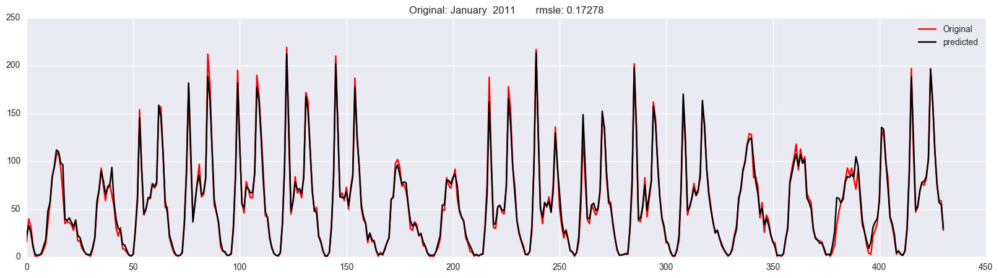

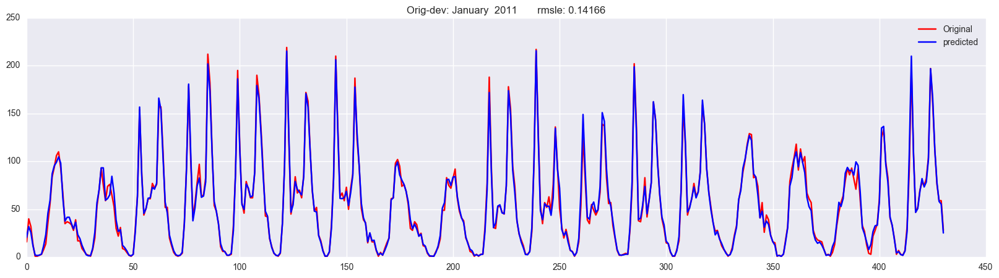

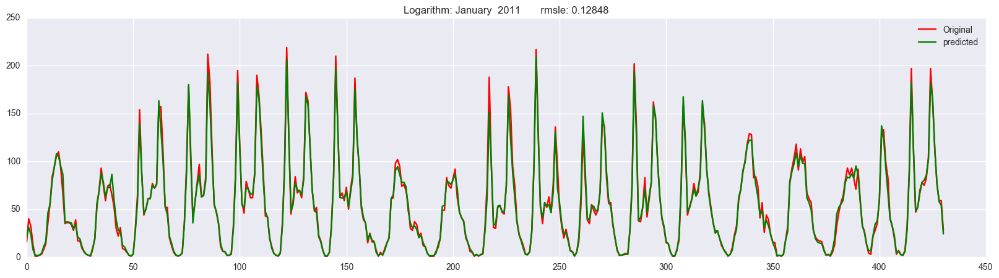

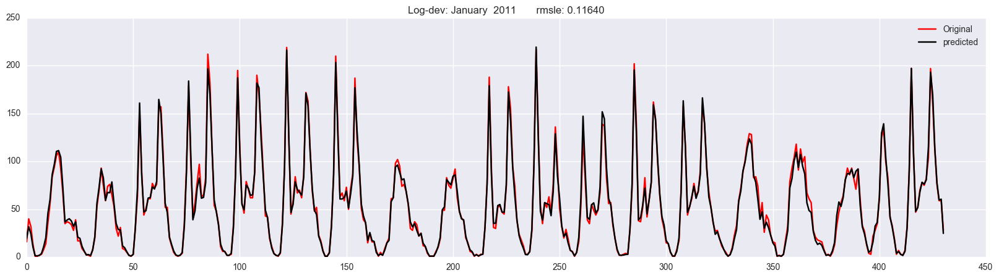

Original: February  2011       rmsle: 0.12655
Orig-dev: February  2011       rmsle: 0.12246
Logarithm: February  2011       rmsle: 0.10518
Log-dev: February  2011       rmsle: 0.10099


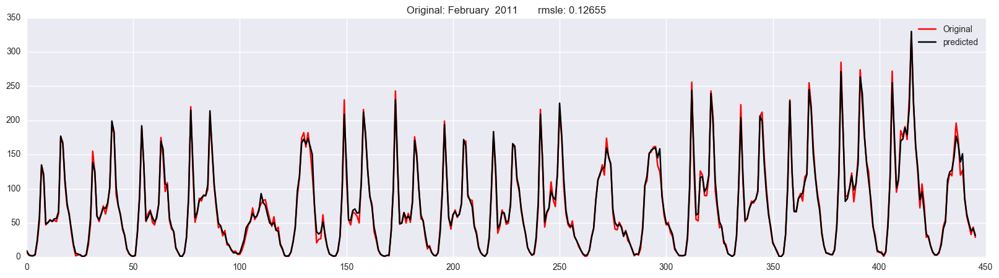

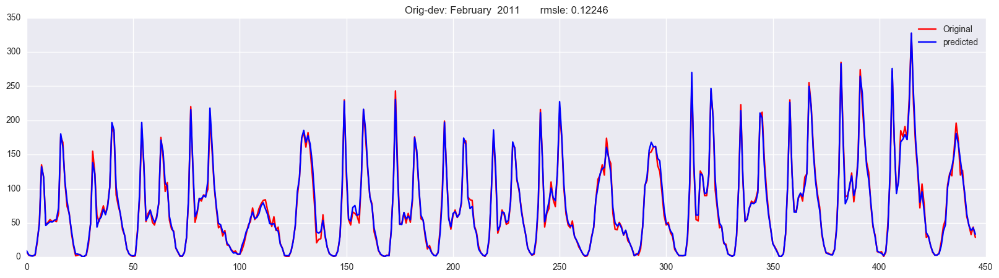

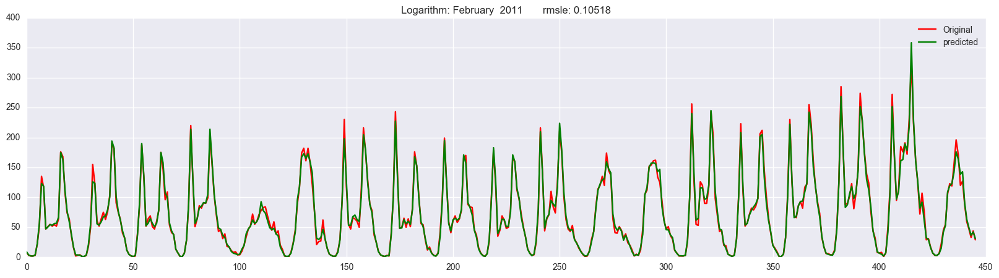

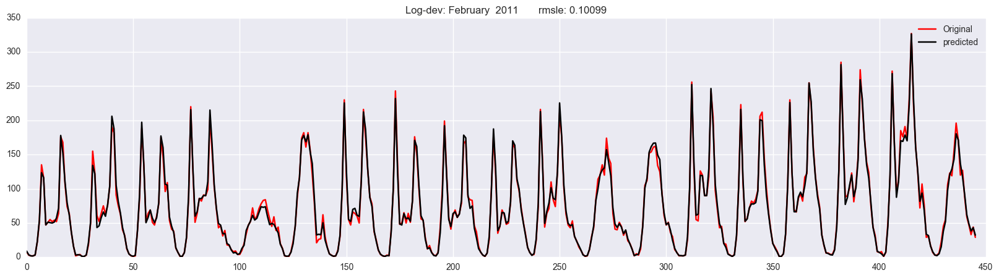

Original: March  2011       rmsle: 0.17652
Orig-dev: March  2011       rmsle: 0.17916
Logarithm: March  2011       rmsle: 0.12882
Log-dev: March  2011       rmsle: 0.12372


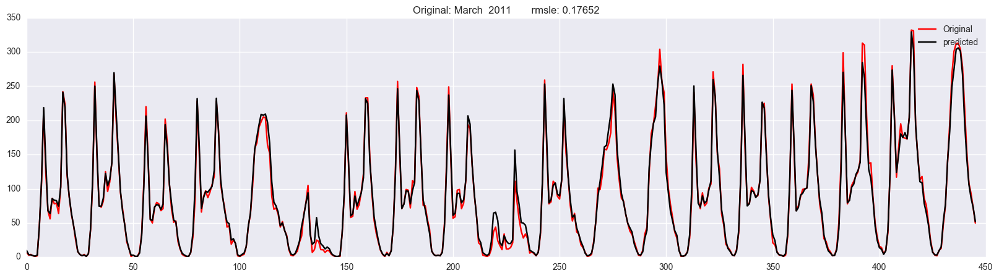

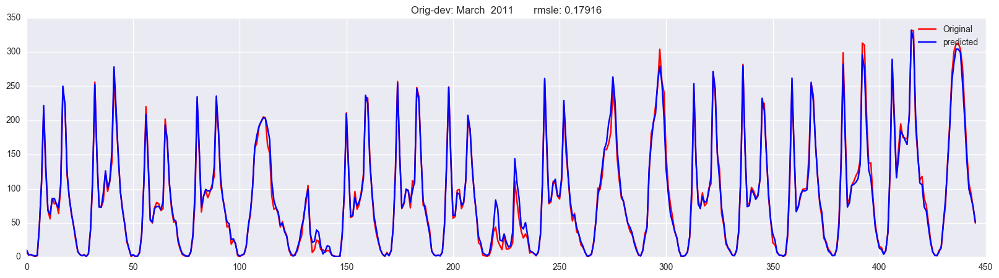

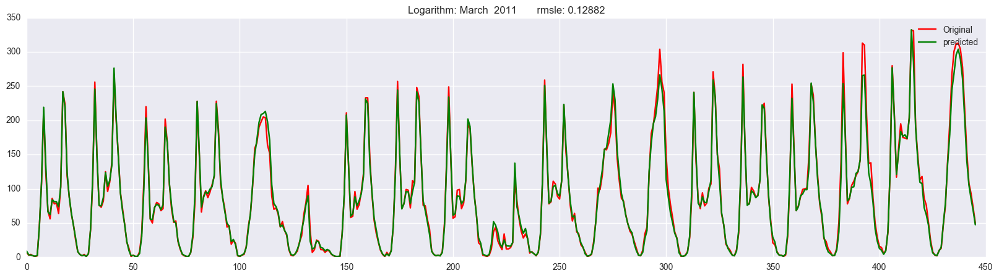

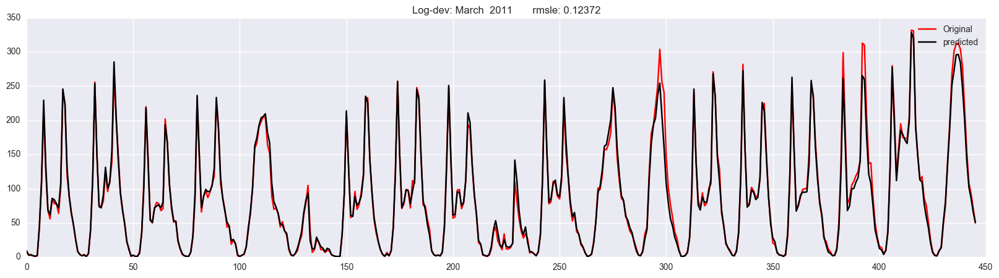

Original: April  2011       rmsle: 0.17966
Orig-dev: April  2011       rmsle: 0.17027
Logarithm: April  2011       rmsle: 0.14143
Log-dev: April  2011       rmsle: 0.14221


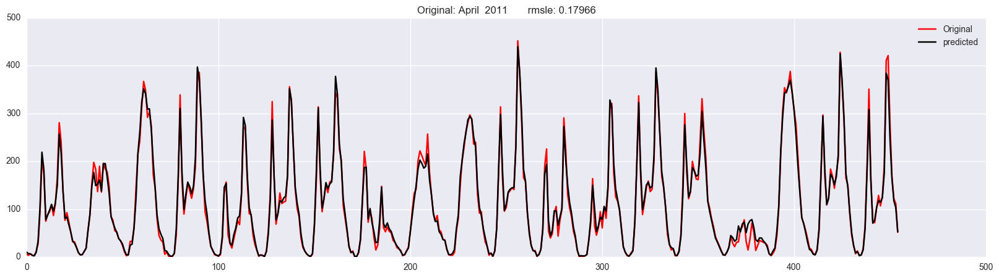

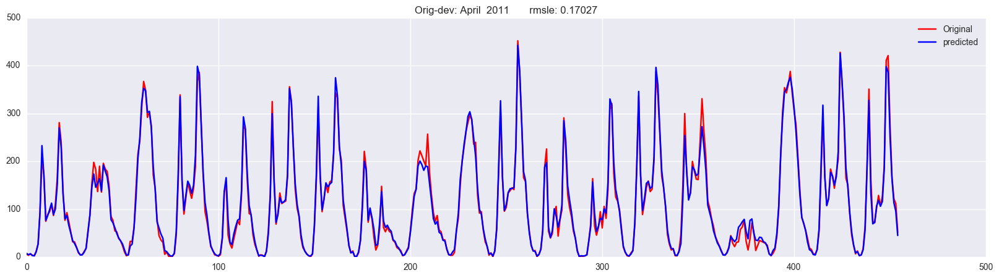

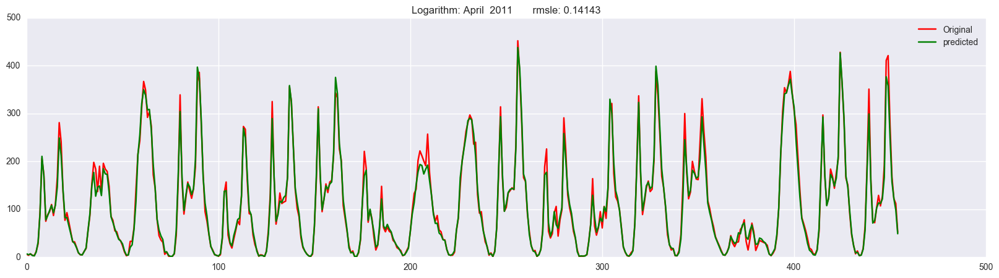

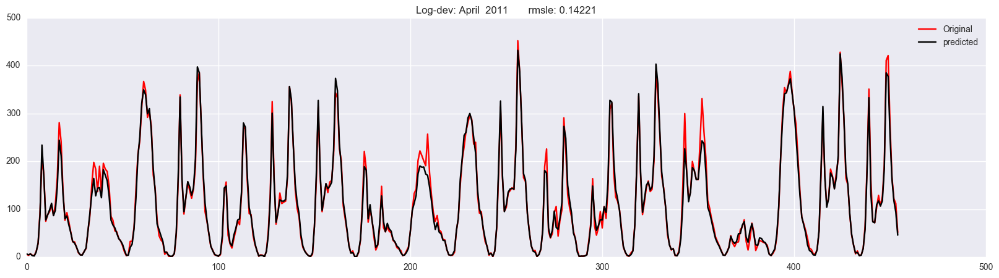

Original: May  2011       rmsle: 0.13166
Orig-dev: May  2011       rmsle: 0.13502
Logarithm: May  2011       rmsle: 0.11538
Log-dev: May  2011       rmsle: 0.11541


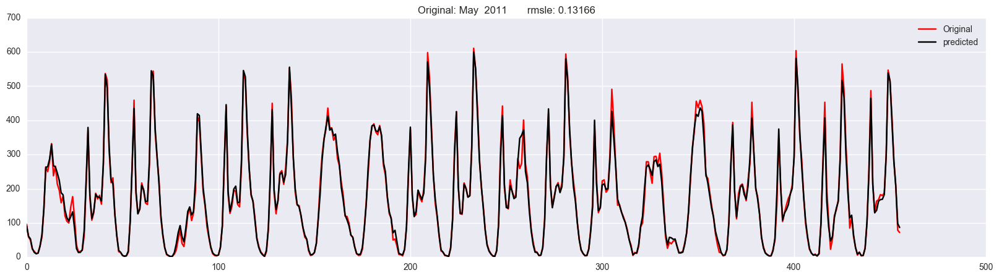

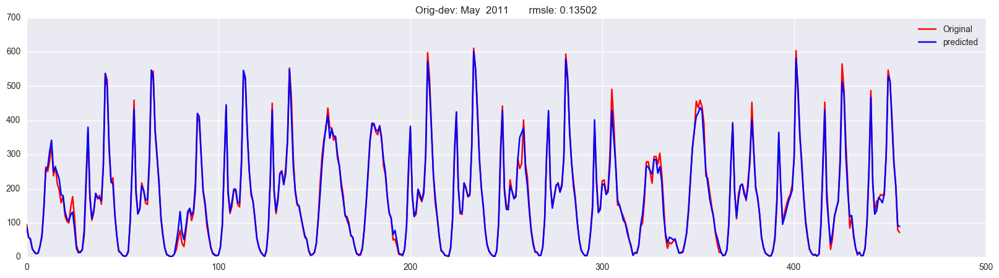

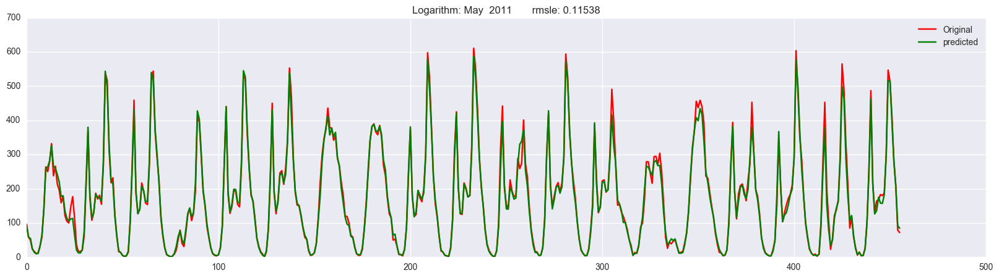

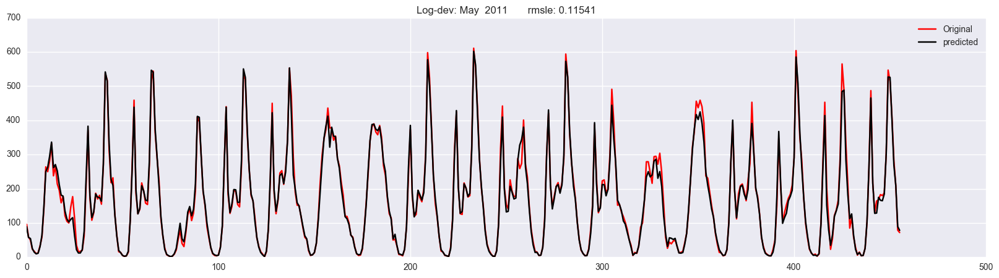

Original: June  2011       rmsle: 0.09178
Orig-dev: June  2011       rmsle: 0.09529
Logarithm: June  2011       rmsle: 0.08084
Log-dev: June  2011       rmsle: 0.07969


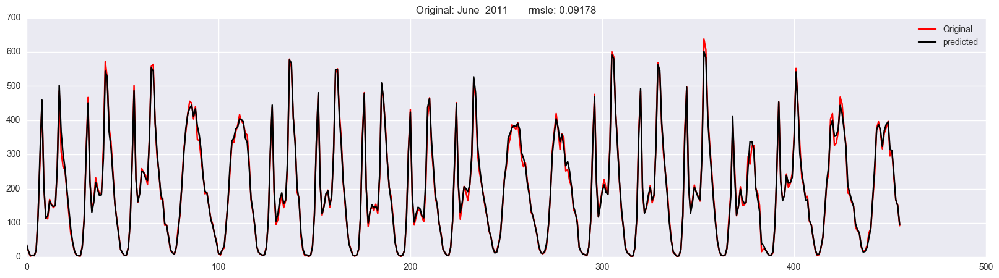

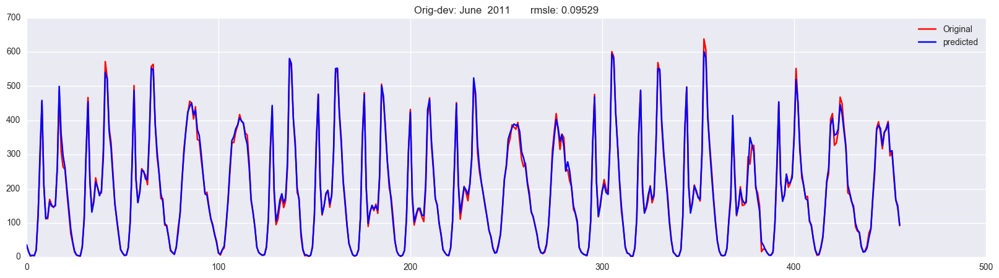

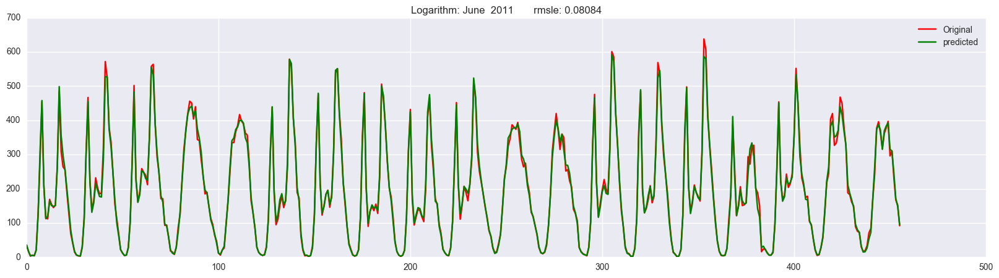

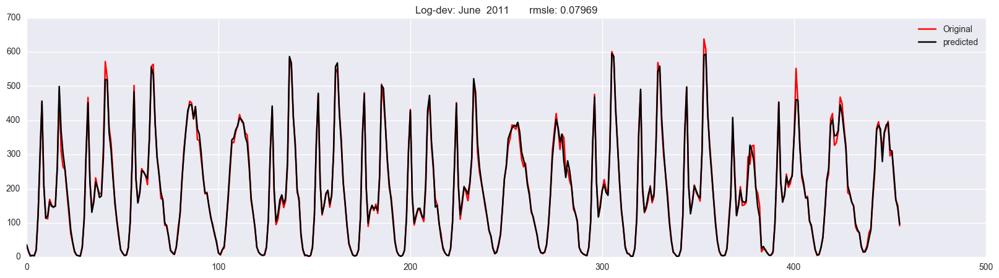

Original: July  2011       rmsle: 0.12925
Orig-dev: July  2011       rmsle: 0.13011
Logarithm: July  2011       rmsle: 0.10143
Log-dev: July  2011       rmsle: 0.09611


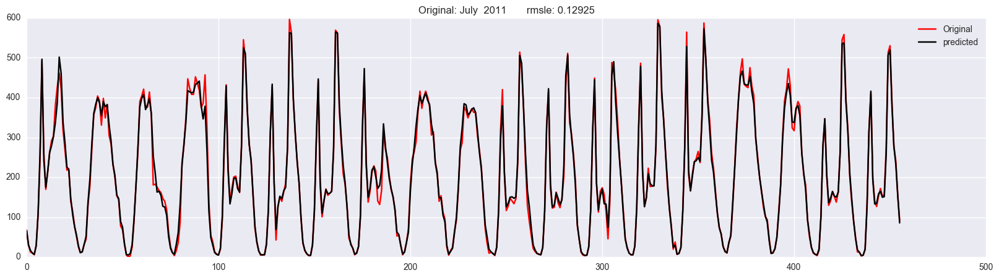

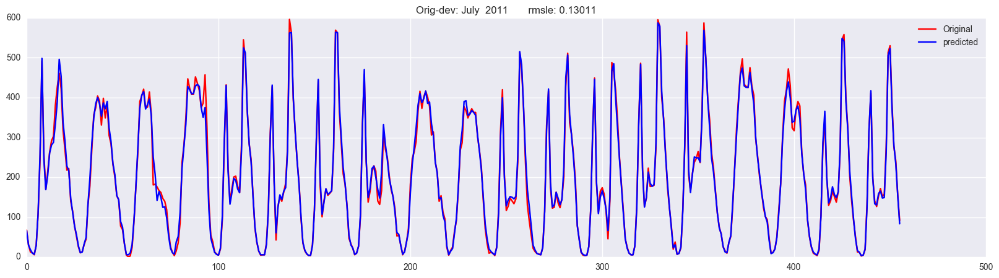

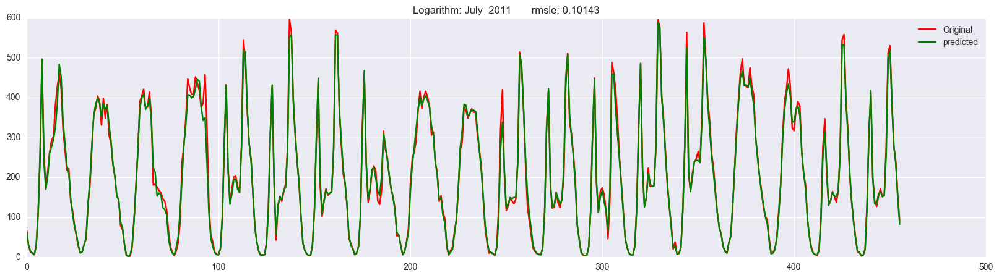

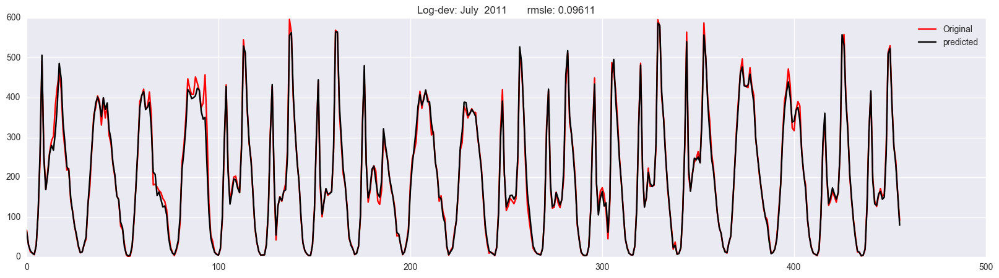

Original: August  2011       rmsle: 0.10514
Orig-dev: August  2011       rmsle: 0.10535
Logarithm: August  2011       rmsle: 0.08571
Log-dev: August  2011       rmsle: 0.08826


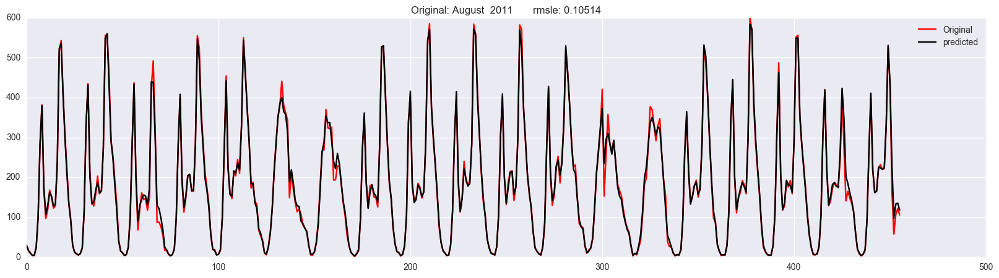

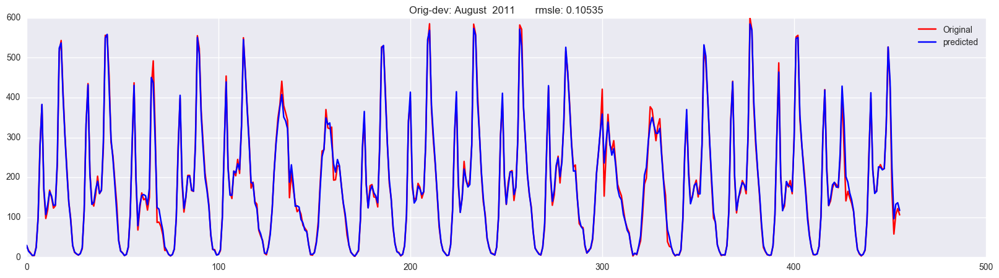

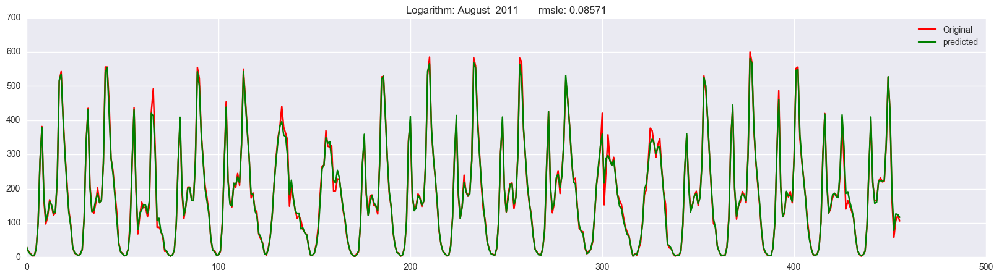

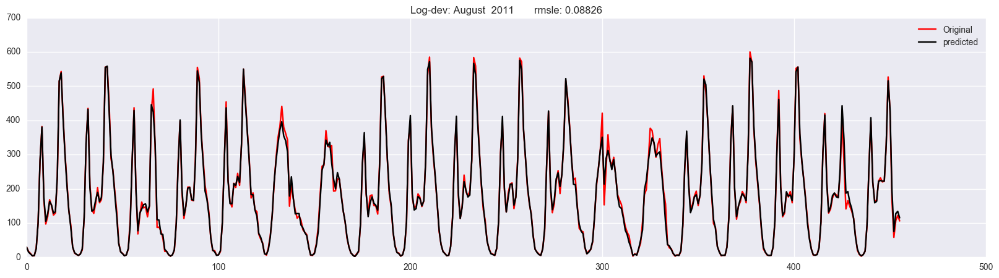

Original: September  2011       rmsle: 0.18521
Orig-dev: September  2011       rmsle: 0.18381
Logarithm: September  2011       rmsle: 0.13510
Log-dev: September  2011       rmsle: 0.12687


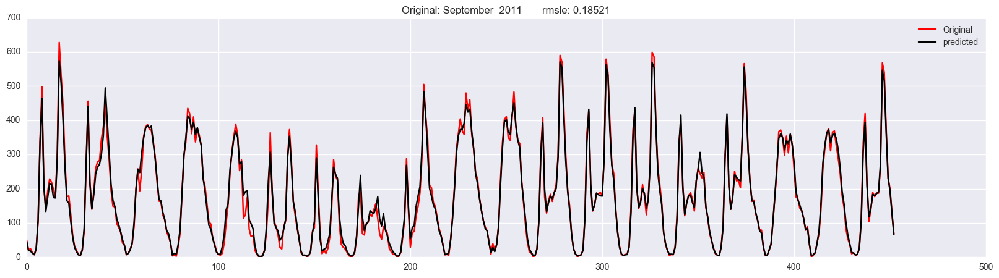

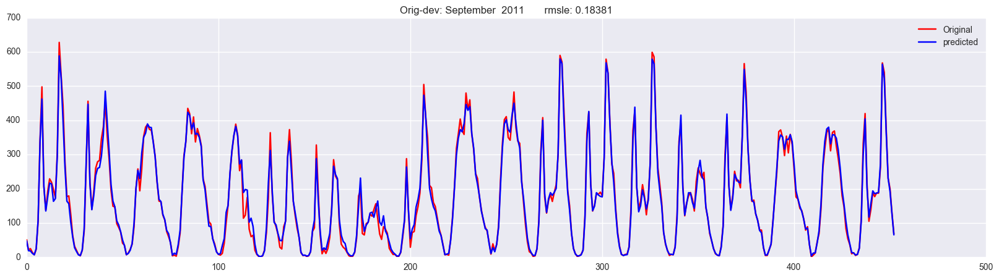

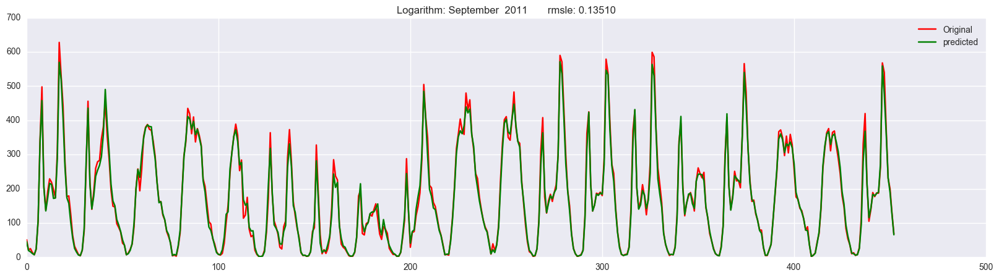

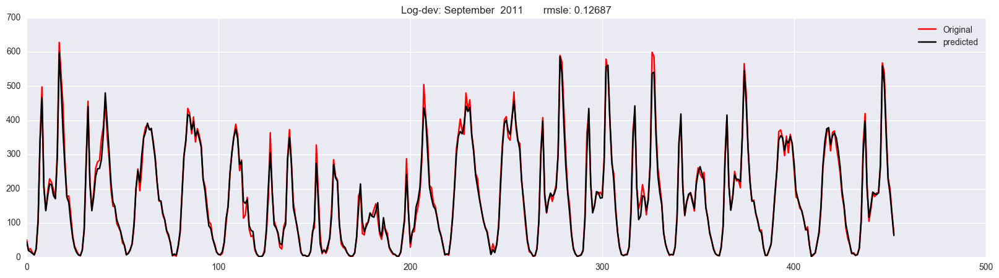

Original: October  2011       rmsle: 0.12276
Orig-dev: October  2011       rmsle: 0.12388
Logarithm: October  2011       rmsle: 0.10426
Log-dev: October  2011       rmsle: 0.09906


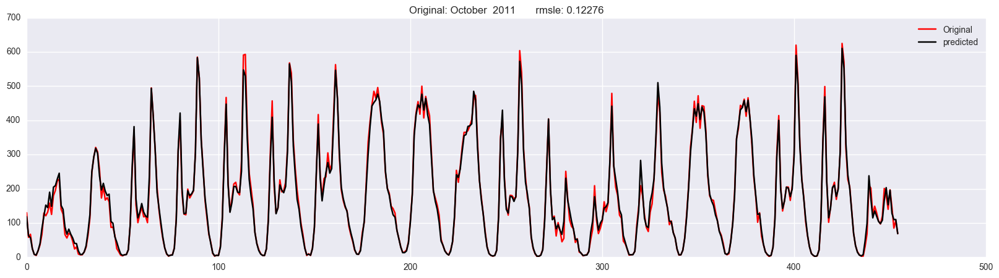

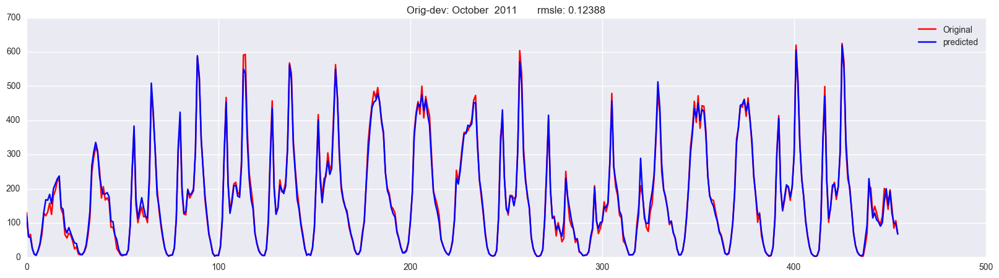

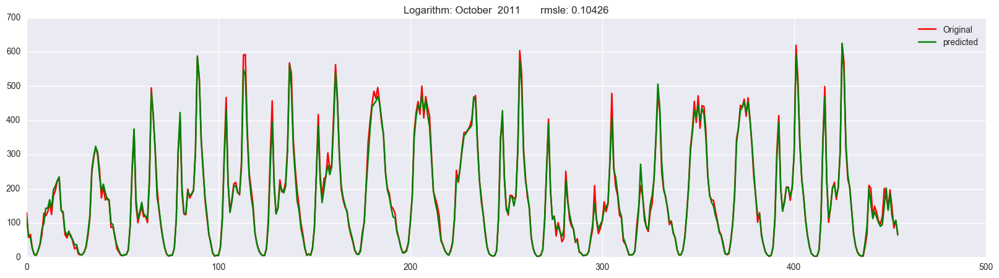

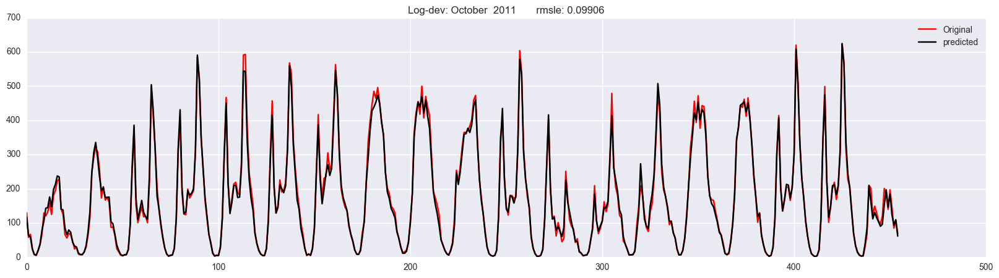

Original: November  2011       rmsle: 0.09632
Orig-dev: November  2011       rmsle: 0.09185
Logarithm: November  2011       rmsle: 0.08766
Log-dev: November  2011       rmsle: 0.08568


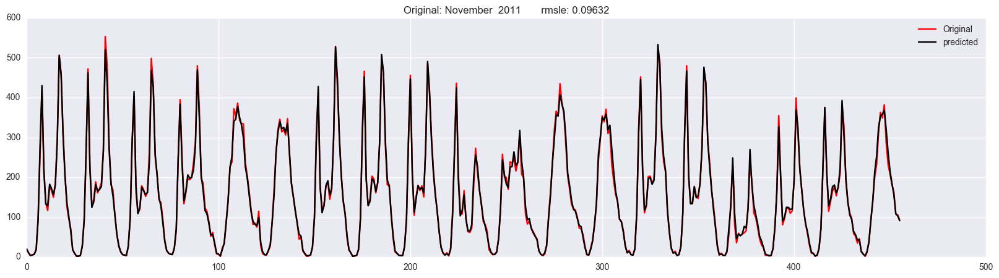

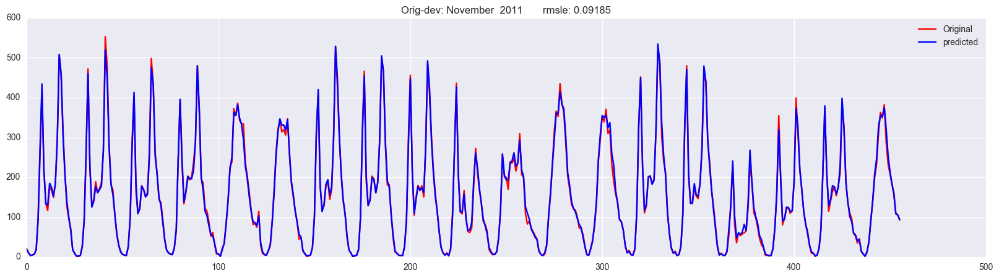

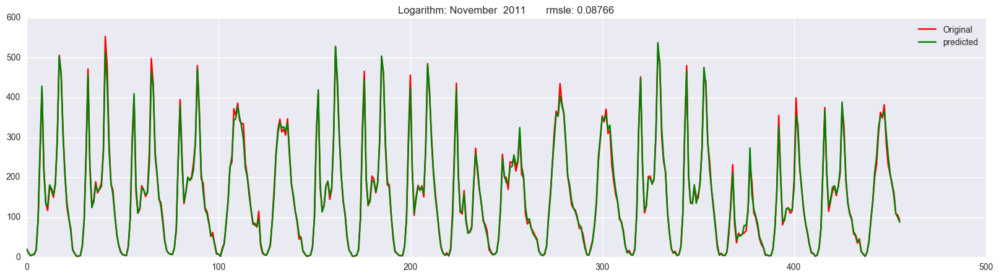

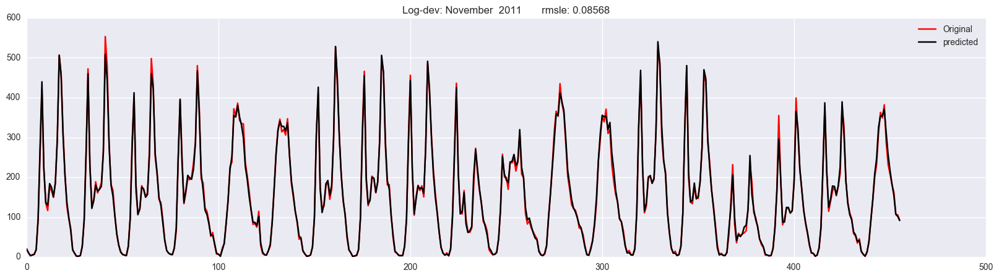

Original: December  2011       rmsle: 0.15030
Orig-dev: December  2011       rmsle: 0.15081
Logarithm: December  2011       rmsle: 0.11909
Log-dev: December  2011       rmsle: 0.11901


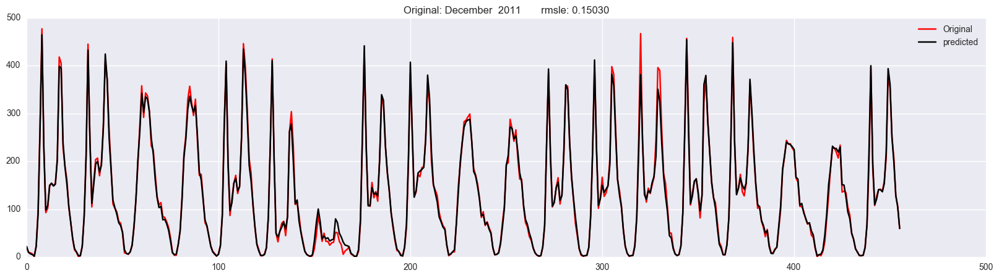

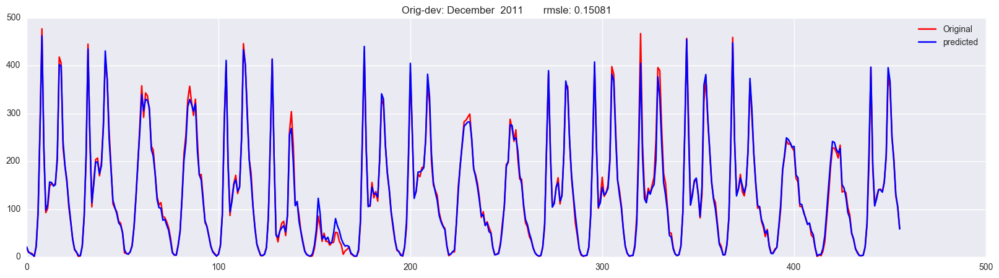

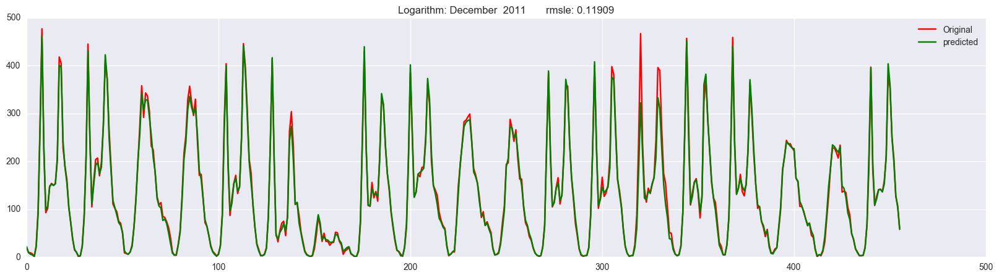

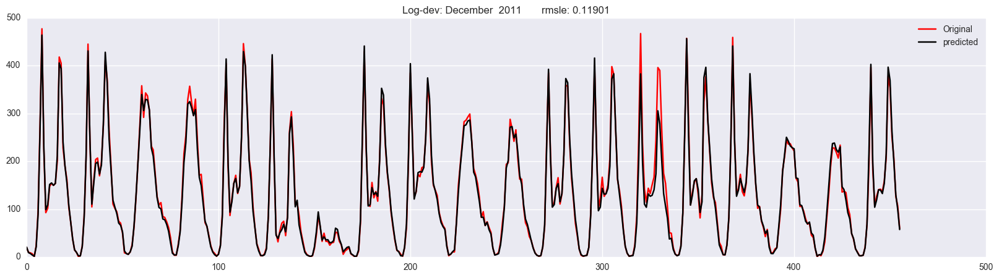

Original: January  2012       rmsle: 0.15543
Orig-dev: January  2012       rmsle: 0.14143
Logarithm: January  2012       rmsle: 0.12497
Log-dev: January  2012       rmsle: 0.11540


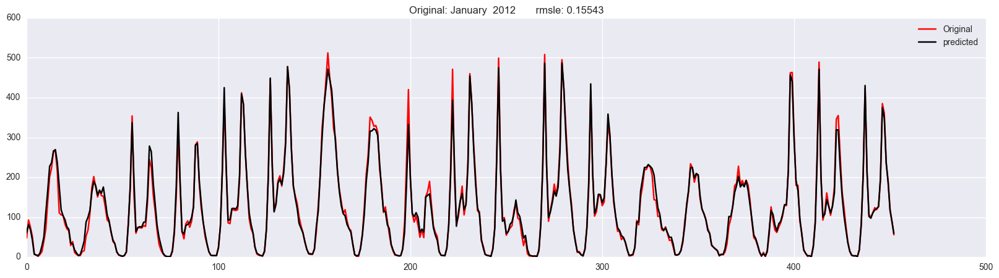

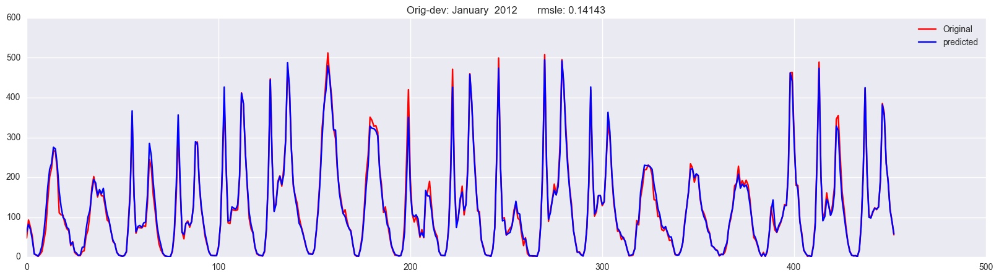

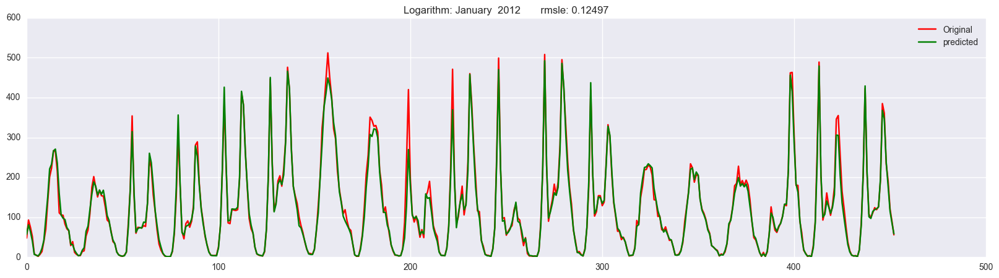

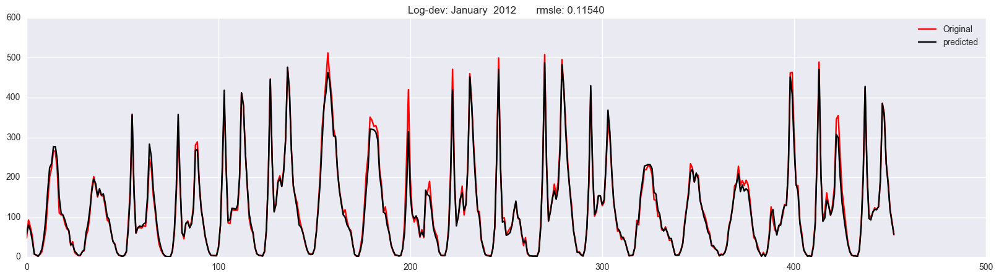

Original: February  2012       rmsle: 0.12619
Orig-dev: February  2012       rmsle: 0.12173
Logarithm: February  2012       rmsle: 0.10646
Log-dev: February  2012       rmsle: 0.10576


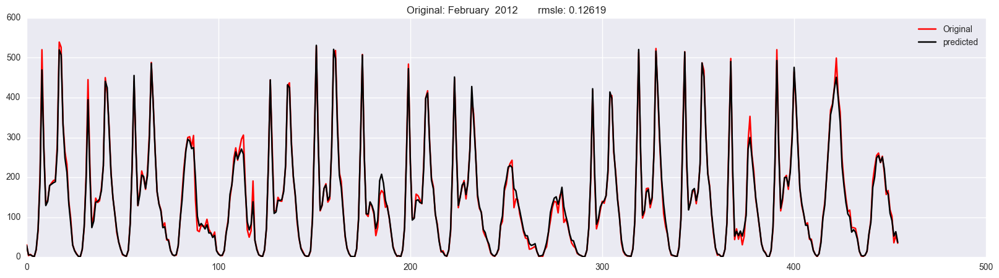

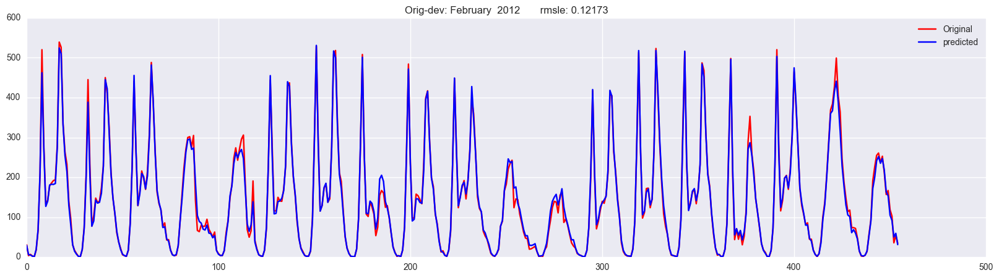

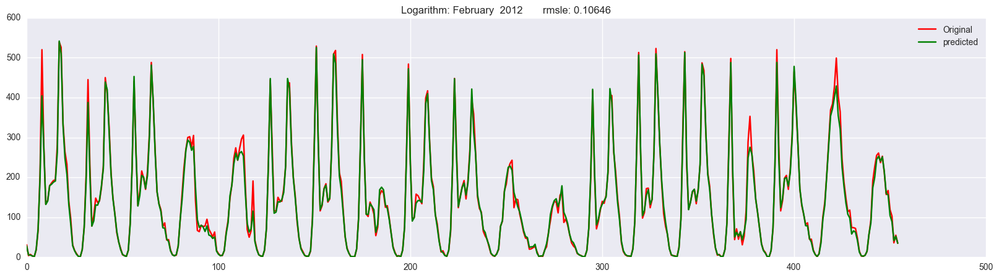

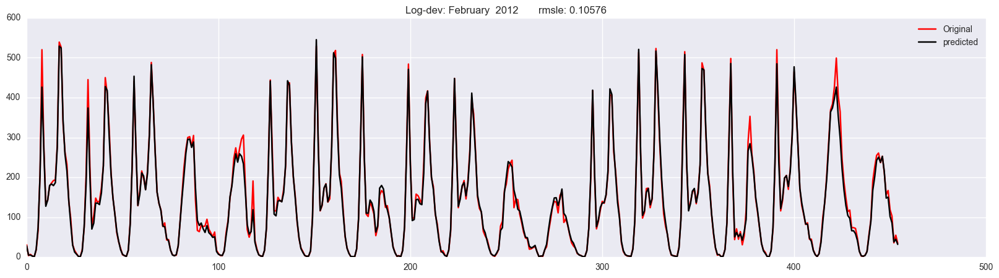

Original: March  2012       rmsle: 0.14914
Orig-dev: March  2012       rmsle: 0.14802
Logarithm: March  2012       rmsle: 0.12482
Log-dev: March  2012       rmsle: 0.11795


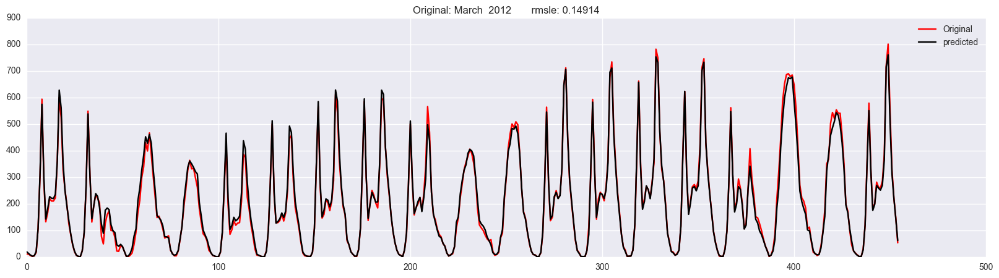

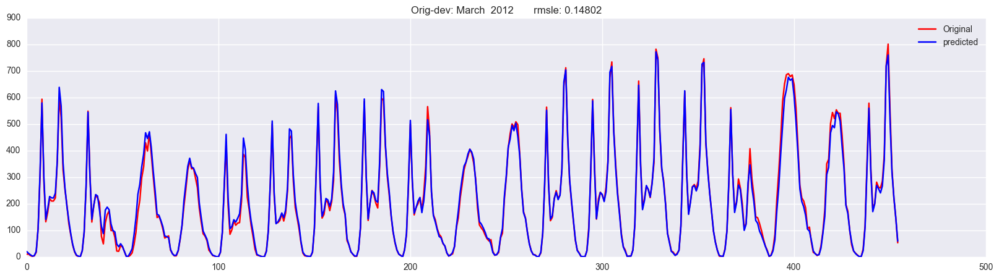

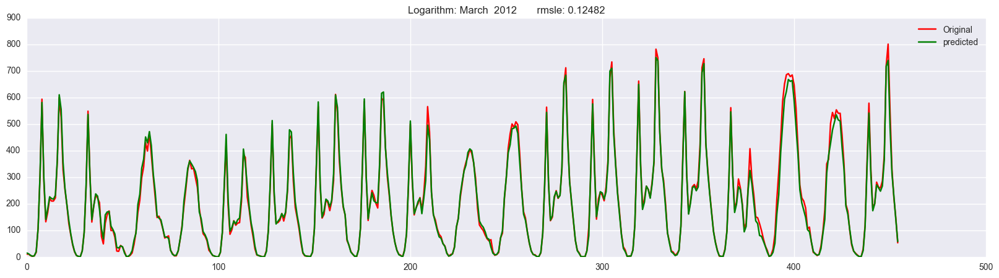

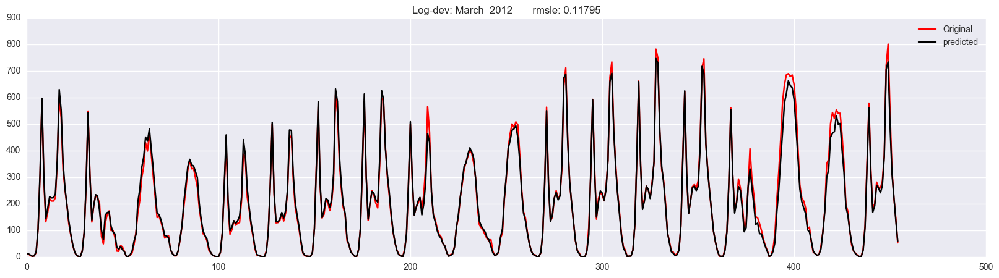

Original: April  2012       rmsle: 0.10729
Orig-dev: April  2012       rmsle: 0.11339
Logarithm: April  2012       rmsle: 0.09737
Log-dev: April  2012       rmsle: 0.10098


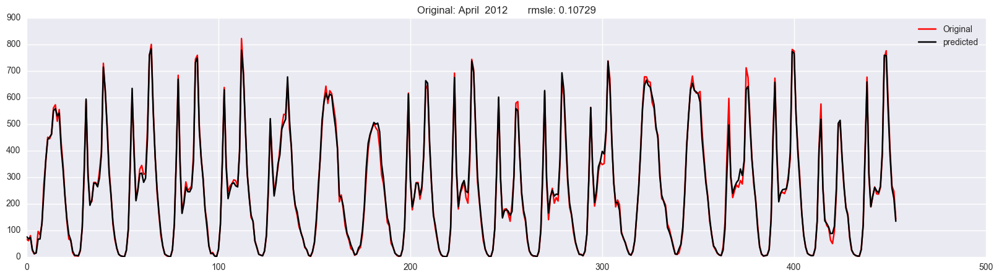

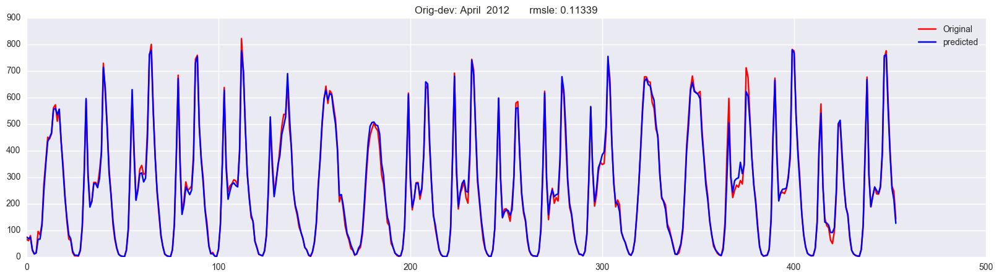

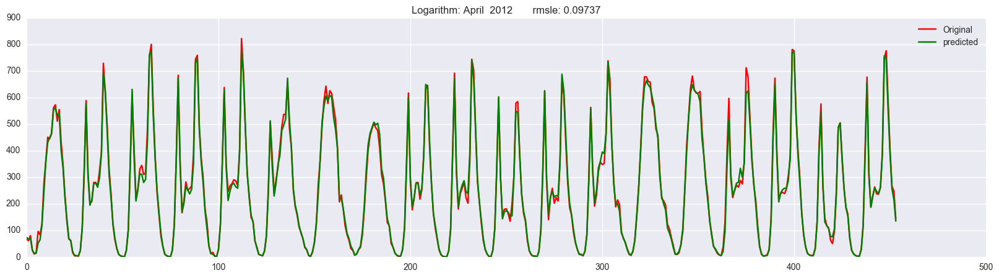

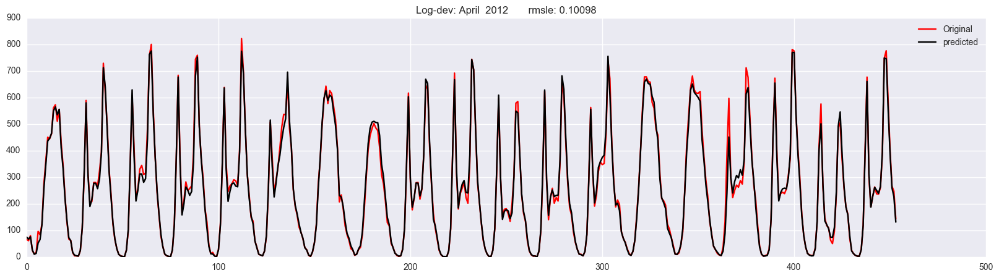

Original: May  2012       rmsle: 0.15015
Orig-dev: May  2012       rmsle: 0.15183
Logarithm: May  2012       rmsle: 0.11239
Log-dev: May  2012       rmsle: 0.10759


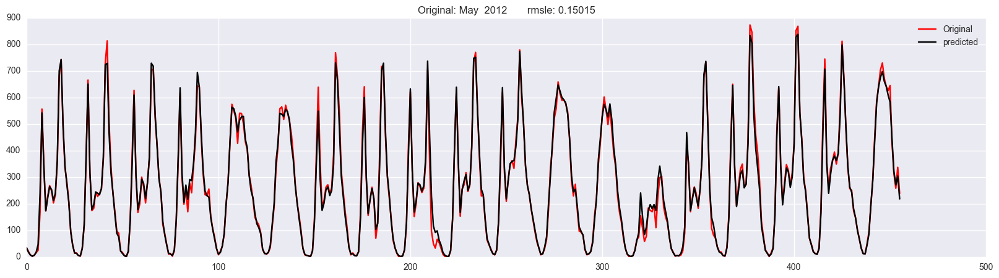

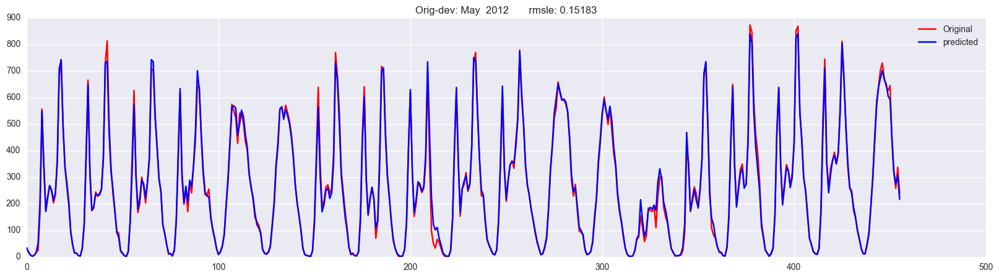

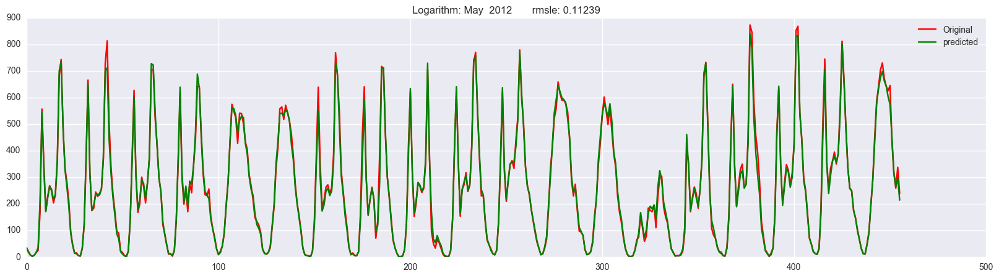

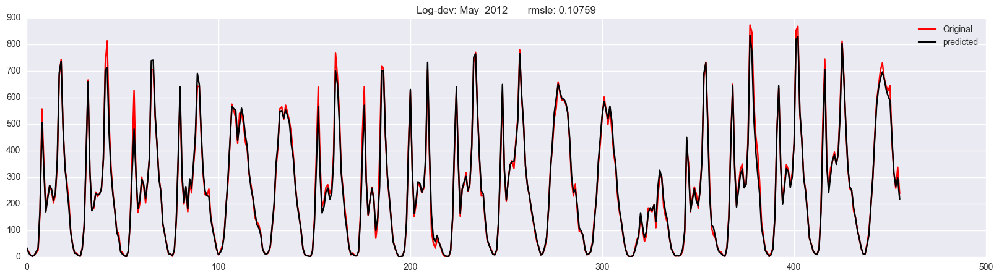

Original: June  2012       rmsle: 0.12140
Orig-dev: June  2012       rmsle: 0.12148
Logarithm: June  2012       rmsle: 0.08634
Log-dev: June  2012       rmsle: 0.08126


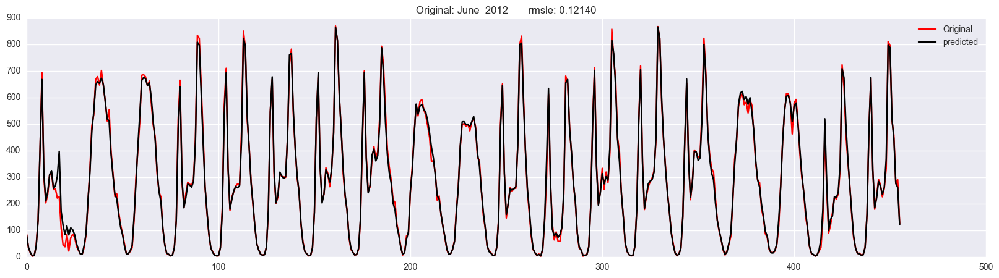

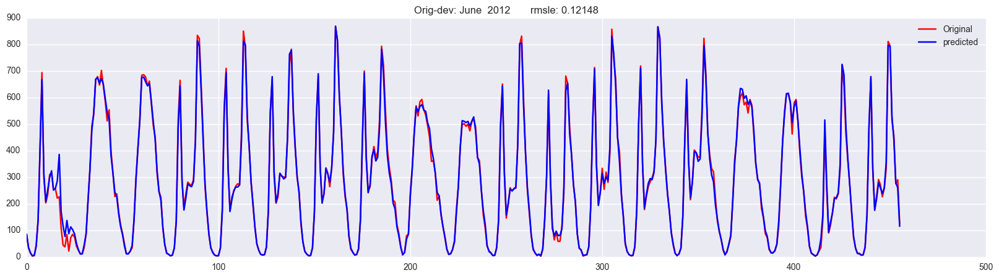

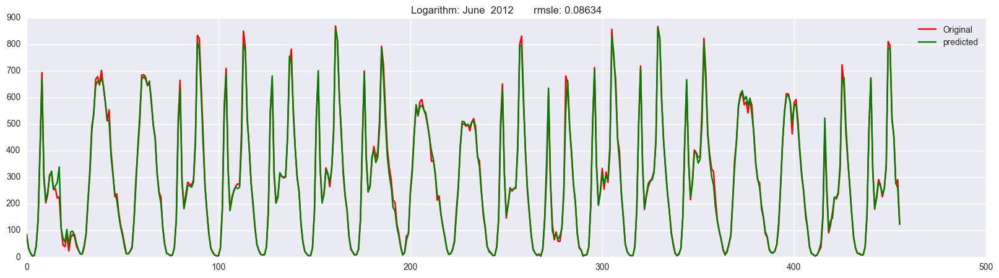

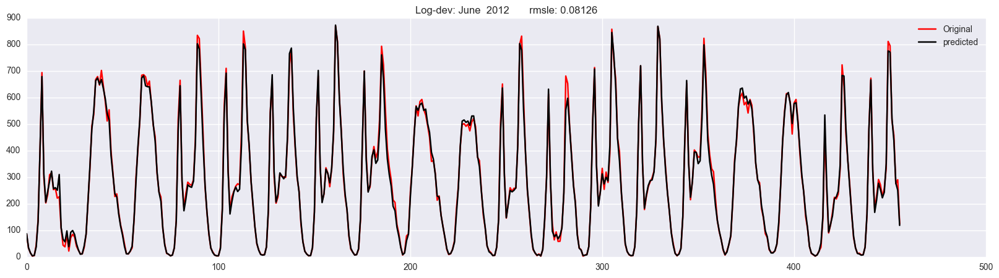

Original: July  2012       rmsle: 0.13430
Orig-dev: July  2012       rmsle: 0.13228
Logarithm: July  2012       rmsle: 0.09664
Log-dev: July  2012       rmsle: 0.09322


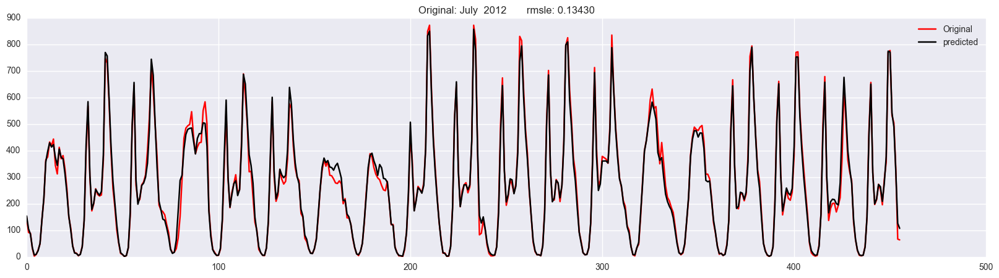

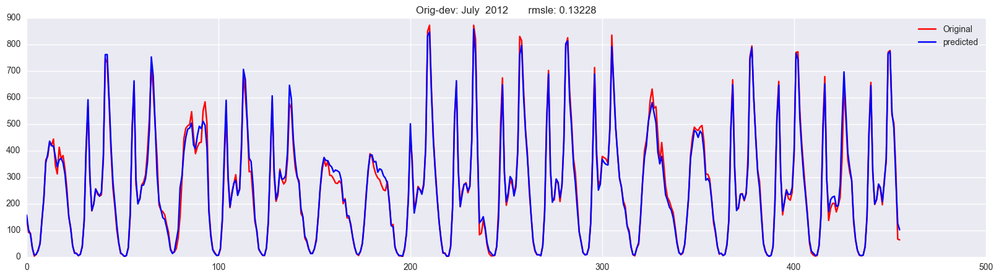

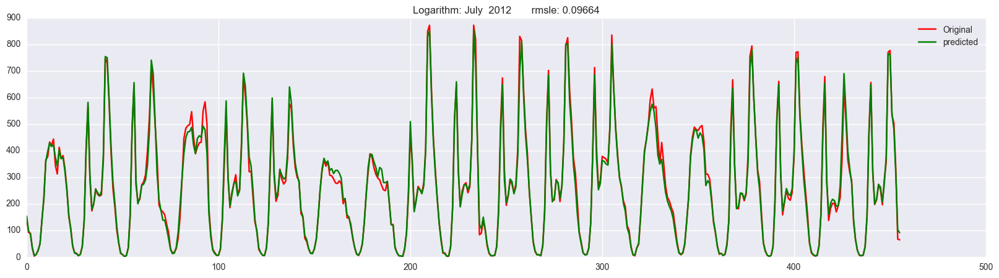

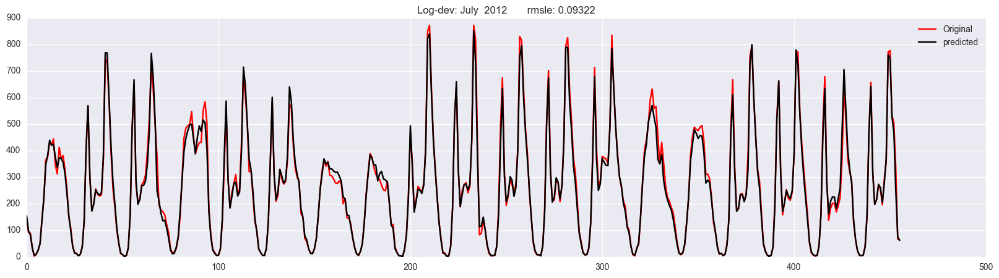

Original: August  2012       rmsle: 0.09080
Orig-dev: August  2012       rmsle: 0.08788
Logarithm: August  2012       rmsle: 0.07563
Log-dev: August  2012       rmsle: 0.07650


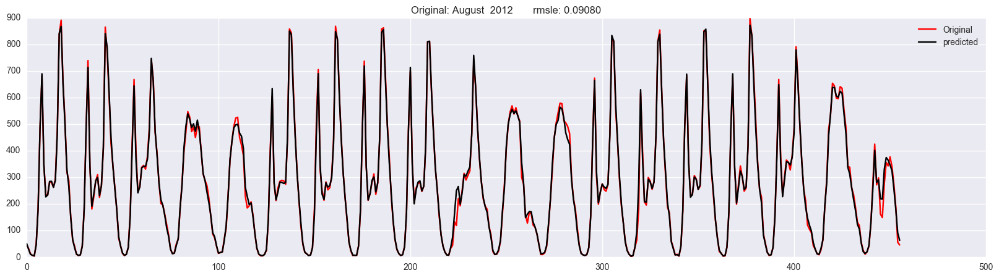

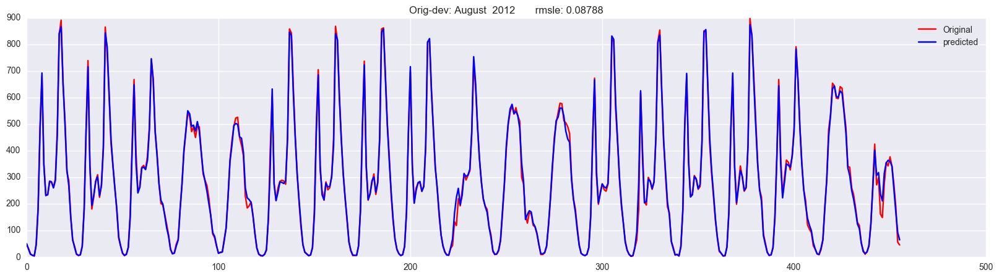

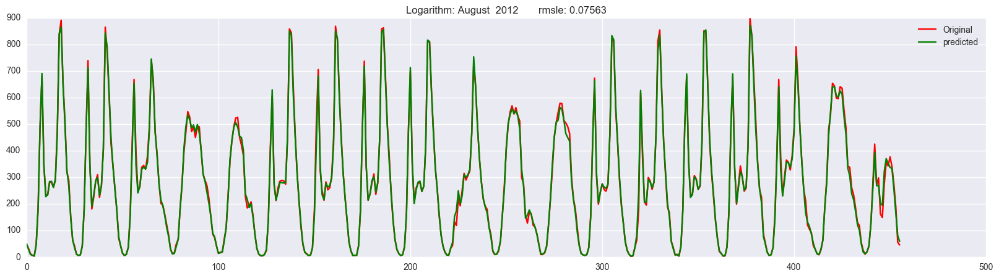

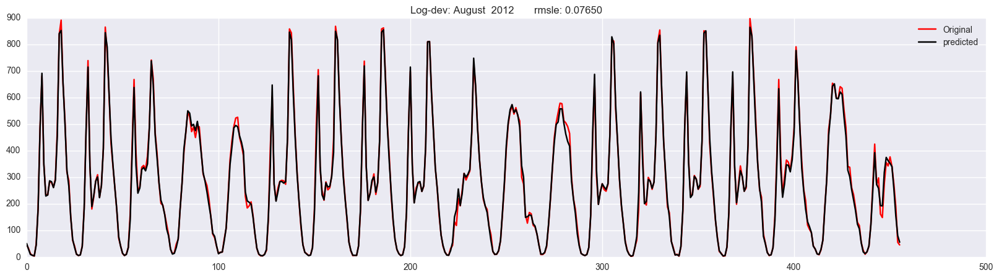

Original: September  2012       rmsle: 0.14863
Orig-dev: September  2012       rmsle: 0.14441
Logarithm: September  2012       rmsle: 0.10428
Log-dev: September  2012       rmsle: 0.10440


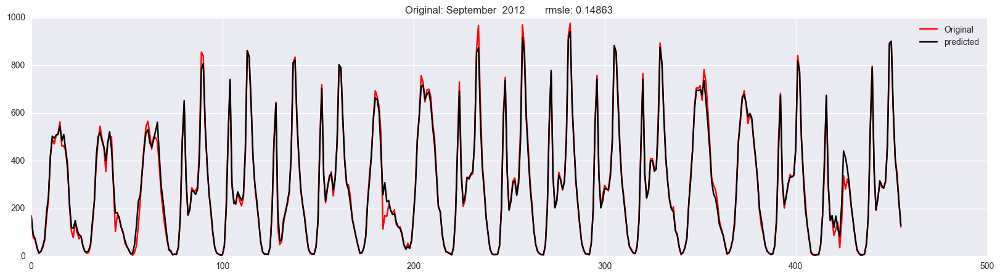

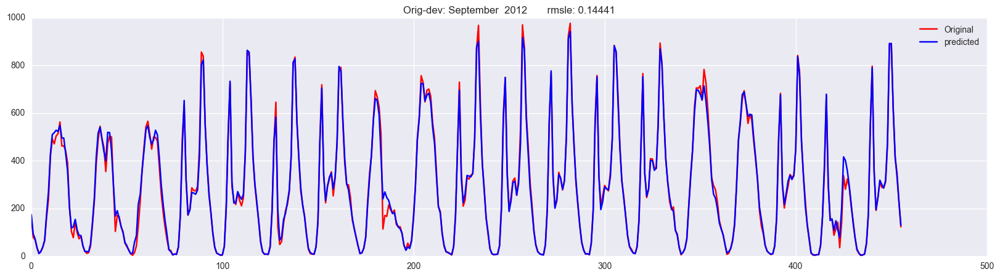

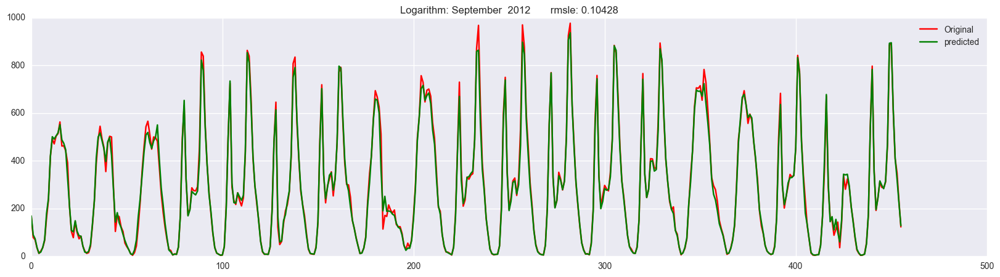

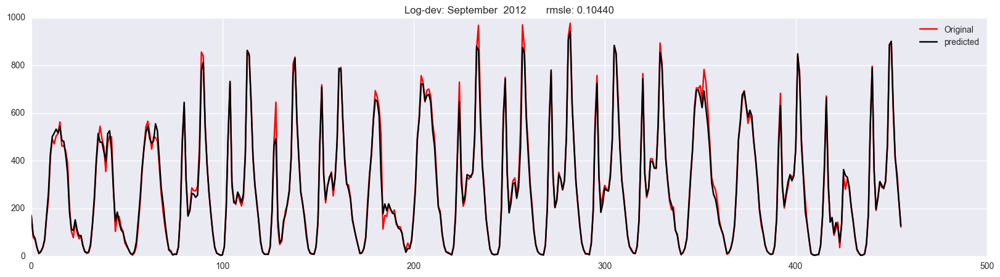

Original: October  2012       rmsle: 0.11566
Orig-dev: October  2012       rmsle: 0.11064
Logarithm: October  2012       rmsle: 0.09796
Log-dev: October  2012       rmsle: 0.09355


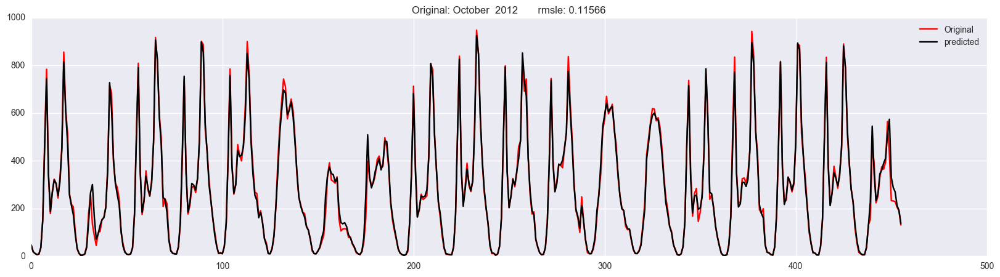

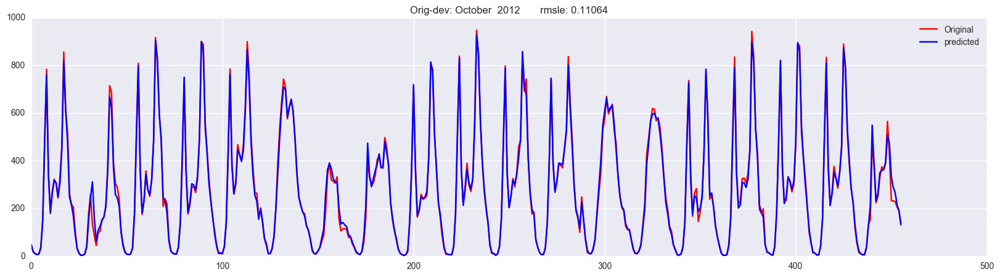

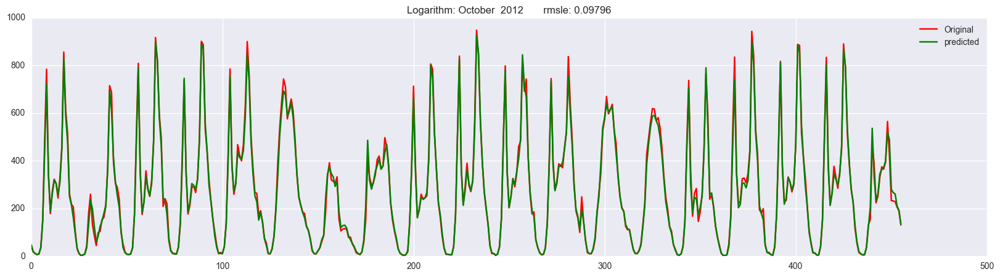

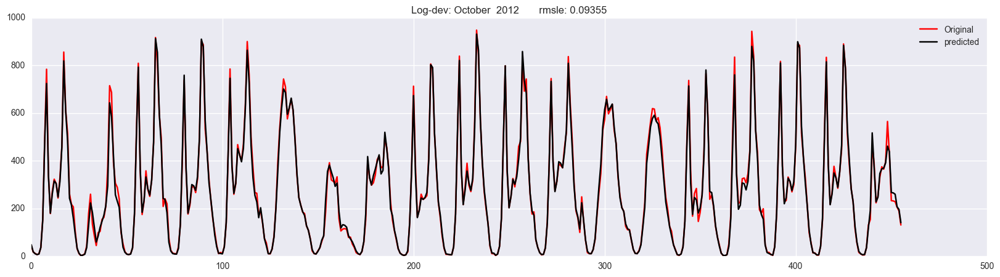

Original: November  2012       rmsle: 0.17068
Orig-dev: November  2012       rmsle: 0.16773
Logarithm: November  2012       rmsle: 0.12344
Log-dev: November  2012       rmsle: 0.11757


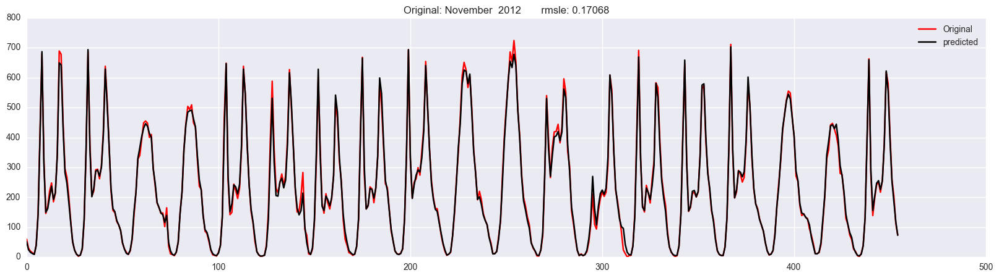

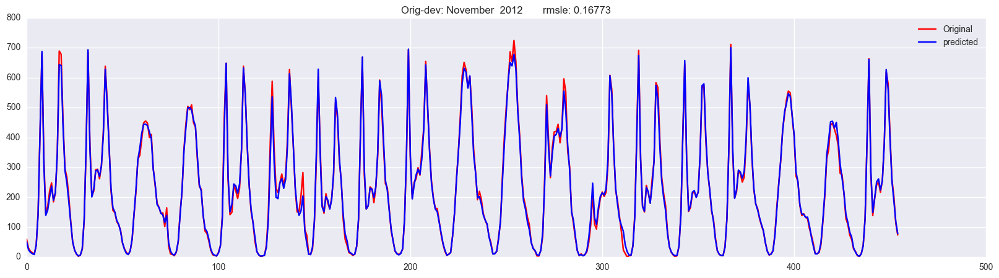

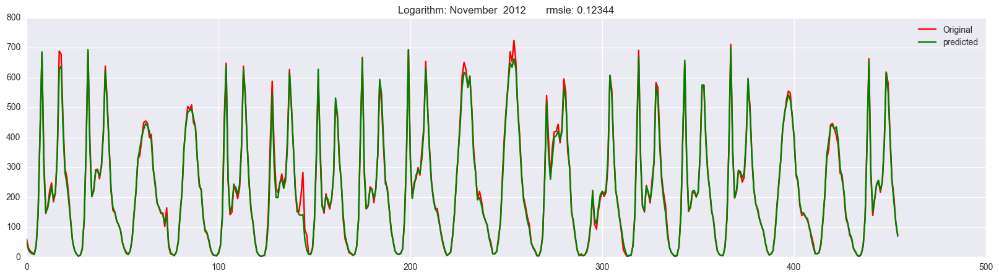

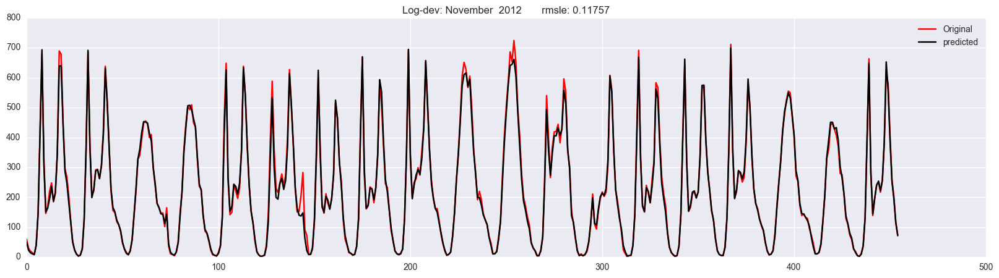

Original: December  2012       rmsle: 0.09634
Orig-dev: December  2012       rmsle: 0.09465
Logarithm: December  2012       rmsle: 0.08814
Log-dev: December  2012       rmsle: 0.08761


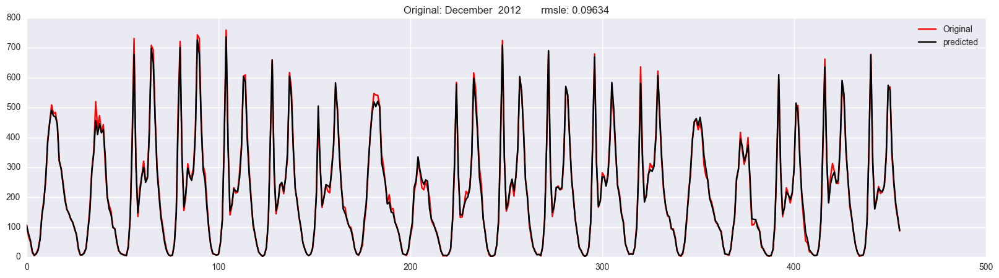

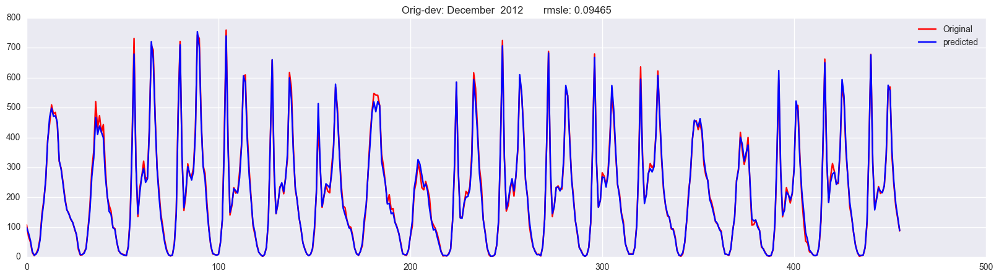

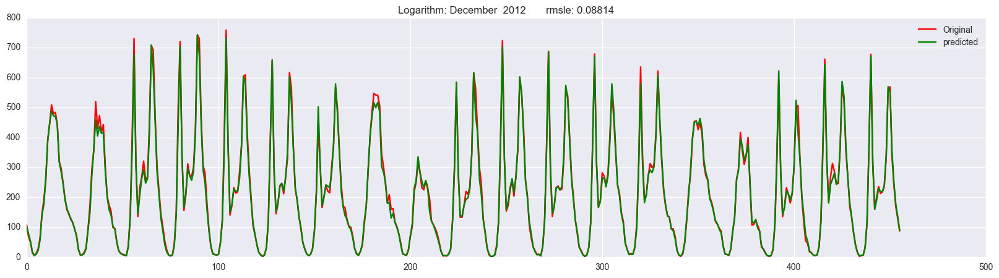

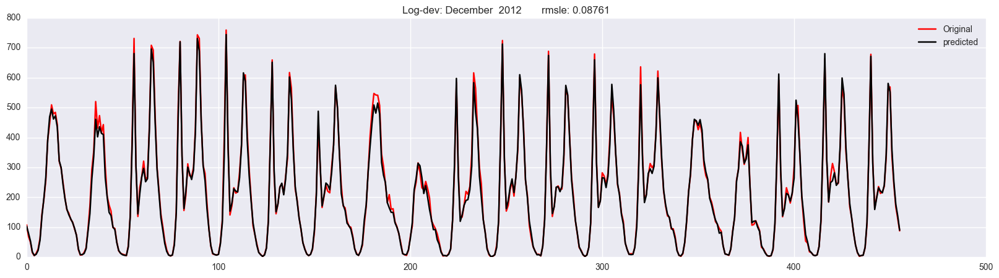

In [119]:
months = ['January','February','March','April','May','June','July', 'August','September','October','November','December']

rmsle_org = []
rmsle_dev = []
rmsle_l = []
rmsle_l_dev = []

for year in [2011,2012]:
    for month in range(1,13):
        
        # print months[month-1], year
        
        mask = (X0.month == month) & (X0.year == year)

        y0 = Y_org[mask].tot
        yhat = rf.predict(X0[mask])        
        print("Original: %s  %d       rmsle: %.5f" % (months[month-1], year,  rmsle(y0,yhat)))
        rmsle_org.append(rmsle(y0,yhat))
        
        
        y0_dev = Y_dev[mask].dev_tot
        yhat_dev = rf_dev.predict(X0[mask])        
        print("Orig-dev: %s  %d       rmsle: %.5f" % (months[month-1], year,  
                                                      rmsle(y0_dev + Y_avg[mask].avg_tot
                                                            ,
                                                            yhat_dev + Y_avg[mask].avg_tot)
                                                     )
             )
        rmsle_dev.append(rmsle(y0_dev + Y_avg[mask].avg_tot, yhat_dev + Y_avg[mask].avg_tot))
       
    
    
        y0_l = Y_org_l[mask].l_tot
        yhat_l = rf_l.predict(X0_l[mask])        
        print("Logarithm: %s  %d       rmsle: %.5f" % (months[month-1], year,  
                                                      rmsle(np.exp(y0_l)-1 ,np.exp(yhat_l)-1)
                                                     )
              )
        rmsle_l.append(rmsle(np.exp(y0_l)-1 ,np.exp(yhat_l)-1))

        y0_dev_l = Y_dev_l[mask].dev_l_tot
        yhat_dev_l = rf_dev_l.predict(X0_l[mask])        
        print("Log-dev: %s  %d       rmsle: %.5f" % (months[month-1], year,  
                                                      rmsle(np.exp(y0_dev_l + Y_avg_l[mask].avg_l_tot)-1 
                                                            ,np.exp(yhat_dev_l + Y_avg_l[mask].avg_l_tot)-1)
                                                     )
              )
        rmsle_l_dev.append(rmsle(np.exp(y0_dev_l + Y_avg_l[mask].avg_l_tot)-1 
                                                            ,np.exp(yhat_dev_l + Y_avg_l[mask].avg_l_tot)-1))

        
        plt.figure(figsize=(20,5))
        plt.plot(range(len(y0)),y0, "r-", label = "Original" )
        plt.plot(range(len(y0)),yhat,"k-", label = "predicted")
        plt.title("Original: %s  %d       rmsle: %.5f" % (months[month-1], year,  rmsle(y0,yhat)))
        plt.legend(loc="upper right")
        plt.show()
 


        plt.figure(figsize=(20,5))
        plt.plot(range(len(y0_dev)),y0_dev + Y_avg[mask].avg_tot, "r-", label = "Original" )
        plt.plot(range(len(y0_dev)),yhat_dev + Y_avg[mask].avg_tot,"b-", label = "predicted")
        plt.title("Orig-dev: %s  %d       rmsle: %.5f" % (months[month-1], year,  
                                                          rmsle(y0_dev + Y_avg[mask].avg_tot
                                                            ,
                                                            yhat_dev + Y_avg[mask].avg_tot)
                                                     ))
        plt.legend(loc="upper right")
        plt.show()

        
        
        plt.figure(figsize=(20,5))
        plt.plot(range(len(y0_dev)),np.exp(y0_l)-1, "r-", label = "Original" )
        plt.plot(range(len(y0_dev)),np.exp(yhat_l)-1,"g-", label = "predicted")
        plt.title("Logarithm: %s  %d       rmsle: %.5f" % (months[month-1], year,  
                                                          rmsle(np.exp(y0_l)-1 ,np.exp(yhat_l)-1)
                                                         ))
        plt.legend(loc="upper right")
        plt.show()    
        
        
        
        plt.figure(figsize=(20,5))
        plt.plot(range(len(y0_dev)),np.exp(y0_dev_l + Y_avg_l[mask].avg_l_tot)-1, "r-", label = "Original" )
        plt.plot(range(len(y0_dev)),np.exp(yhat_dev_l + Y_avg_l[mask].avg_l_tot)-1,"k-", label = "predicted")
        plt.title("Log-dev: %s  %d       rmsle: %.5f" % (months[month-1], year,  
                                                          rmsle(np.exp(y0_dev_l + Y_avg_l[mask].avg_l_tot)-1 
                                                            ,np.exp(yhat_dev_l + Y_avg_l[mask].avg_l_tot)-1)
                                                         ))
        plt.legend(loc="upper right")
        plt.show()    

## RMSLE for each month and different data representation

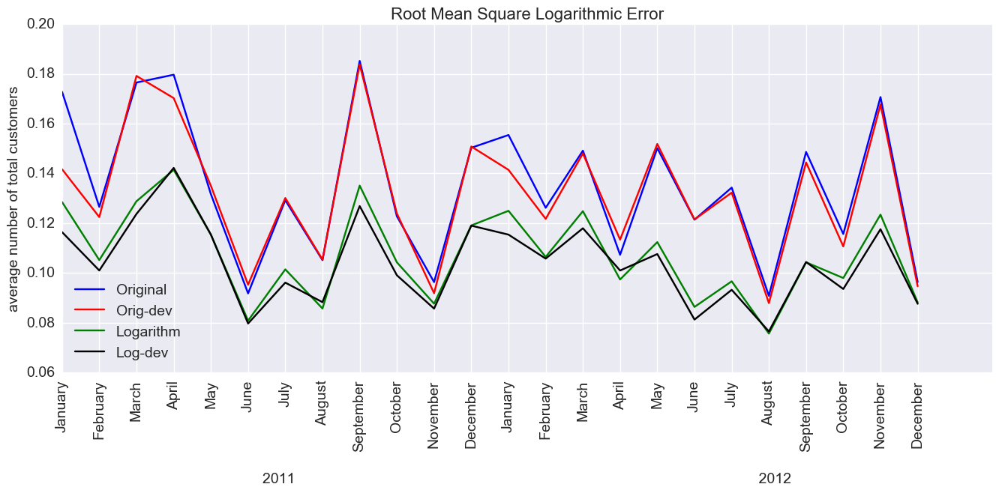

In [120]:
plt.figure(num=None, figsize=(16, 6), dpi=80, facecolor='w', edgecolor='k')

plt.plot(rmsle_org, "b-")
plt.plot(rmsle_dev, "r-")
plt.plot(rmsle_l, "g-")
plt.plot(rmsle_l_dev, "k-")


plt.title('Root Mean Square Logarithmic Error',fontsize=16)
plt.legend(['Original','Orig-dev','Logarithm', 'Log-dev'], loc = 'best', fontsize = 14)    
plt.xticks(range(24), months*2,rotation = 90, fontsize = 14)  
plt.yticks(fontsize = 14)
plt.xlabel("\n2011".ljust(120)+"2012", fontsize = 14)
plt.ylabel("average number of total customers", fontsize = 14)
#plt.axis((-.5,23.5,0,max_y + 20))    
plt.show() 

### Note:
In th majority of months the `log-dev` data value gives the best `rmsle` values.